<a href="https://colab.research.google.com/github/everythingapplejj/Research-Graph-Embeddings-/blob/JJ/mcmc_samples_with_Data_cleaning_beta_11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-{torch.__version__}.html
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-{torch.__version__}.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 kB 1.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.0/210.0 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [2]:
# this version is without the VID

In [3]:
# this program is with the pre_data cleaning :)
# Duplicated nodes from the node_list and adj_matrix will be removed
# This google colab includes the methodology for graph embeddings. And removing the subgraphs.

In [4]:
accuracy_collector = []

In [5]:
print("Welcome to Graph Embeddings!")

Welcome to Graph Embeddings!


In [6]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
#testing visualization
#Implementation by Jiwoong Jung
import torch

#placeholder values:

# Print information about the dataset


# Visualization
import networkx as nx
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 300
plt.rcParams.update({'font.size': 24})
from torch_geometric.utils import to_networkx
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
"""
Created on Wed Aug 23 12:22:38 2023

@author: vishalr
"""

# we can use the node labels for the first set of the x values
# figure out ways to include diff files for the y_features (1st priority)
# for now, do the y label first,
# later consider the edge features and node features

import pandas as pd
import pickle
import numpy as np


#change this to the folder where you store your data
data_dir = ""

#each of the two data frames below have 20,000 rows, each corresponding to one sample from the original graph
#each sample consists of 21 nodes; node_labels contains the names of these 21 nodes of the form Vxyz
#each node is a DNA fragment of length 500 bases; so Vxyz coveres region [500*xyz, 500*xyz+500)
#adjacency_matrix has the flattended adjacecny matrix for each of these 20,000 samples
#so each row is of dimension 21*21 = 441


#node_labels = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')

#adjacency_matrix = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels = []
worklist_adjacency_matrix = []

#importing the rest of the files
# 2L = 0; 2R = 1; 3L = 2, 3R = 3

node_labels_2L = np.load(data_dir+'df_chr2L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_2L = np.load(data_dir+'df_chr2L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_2L)
worklist_adjacency_matrix.append(adjacency_matrix_2L)

node_labels_2R = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_2R = np.load(data_dir+'df_chr2R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_2R)
worklist_adjacency_matrix.append(adjacency_matrix_2R)

node_labels_3L = np.load(data_dir+'df_chr3L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_3L = np.load(data_dir+'df_chr3L_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')

worklist_node_labels.append(node_labels_3L)
worklist_adjacency_matrix.append(adjacency_matrix_3L)

node_labels_3R = np.load(data_dir+'df_chr3R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot_sample_node_matrix.npy')
adjacency_matrix_3R = np.load(data_dir+'df_chr3R_drosophila_ChIA_Drop_0.1_PASS_20000_MCMC_pivot.npy')


worklist_node_labels.append(node_labels_3R)
worklist_adjacency_matrix.append(adjacency_matrix_3R)

In [7]:
import numpy as np
print(worklist_node_labels)

[array([[ 5997, 19835,   969, ...,  4455, 27017, 27025],
       [41207, 22040, 41207, ...,   135,   186,   153],
       [13615, 16412, 16377, ..., 41754, 41780, 41767],
       ...,
       [39599,  9995, 38842, ..., 33868, 20856, 14348],
       [39954,  9995, 10131, ...,  2117,  2259,  2251],
       [32509, 19793, 19783, ...,  7313, 42107, 41499]]), array([[34307, 23565,  5042, ...,  5114, 12844, 12993],
       [36450, 36179, 36450, ..., 22359, 28058, 30979],
       [36450, 36179, 33947, ...,  9673, 20209, 12537],
       ...,
       [ 7427, 39513, 19626, ..., 25109, 25119, 27062],
       [33656, 20125, 24230, ..., 28043, 29127, 29091],
       [ 8127, 38554,  7700, ..., 24445, 25489,  3057]]), array([[41331,  1284,  1255, ..., 32082, 18737, 18660],
       [ 1284,  1349,  1363, ...,  3939,  5692, 17395],
       [24386,  5147, 32020, ..., 28096,  6446, 41308],
       ...,
       [ 3375, 19321,  1419, ..., 17371, 28421, 17371],
       [44210,  1306,  3592, ..., 11490,  1774, 35930],
       

In [8]:
print(worklist_adjacency_matrix)

[array([[ 0.,  1.,  1., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  1., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  1., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.]]), array([[ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       [ 0.,  1.,  0., ...,  1.,  0., -1.],
       ...,
       [ 0.,  1.,  0.

In [9]:
for i in range(0,len(worklist_adjacency_matrix)):
  worklist_adjacency_matrix[i] = worklist_adjacency_matrix[i][:,:-1]
#adjacency_matrix = adjacency_matrix[:,:-1]

In [10]:
print(worklist_adjacency_matrix)

[array([[0., 1., 1., ..., 0., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 1., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 1., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.]]), array([[0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 1., 1., 0.]])]


In [11]:
# proceeding with data cleaning:
import numpy as np
def remove_duplicates(node_labels, adj_matrix):
  sample_nodes = node_labels
  sample_adj_matrix = adj_matrix
  i = 0
  j = i + 1
  while(i < len(sample_nodes) - 1):
    if(sample_nodes[i] == sample_nodes[j]):
      sample_nodes = np.delete(sample_nodes,j)
      sample_adj_matrix = np.delete(np.delete(sample_adj_matrix, j, 0), j, 1)
      if(j >= len(sample_nodes)):
        i = i + 1
        j = i + 1
      continue
    else:
      j = j + 1
      if(j >= len(sample_nodes)):
        i = i + 1
        j = i + 1
  return sample_nodes, sample_adj_matrix

In [12]:
#next

In [13]:
#placeholder logics

import torch
from torch_geometric.data import Data, InMemoryDataset
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
import numpy as np

class MyCustomDataset(InMemoryDataset):
    def __init__(self, data_list, transform=None, pre_transform=None):
        self.data_list = data_list
        super(MyCustomDataset, self).__init__(None, transform, pre_transform)
        self.data, self.slices = self.collate(data_list)

    @property
    def raw_file_names(self):
        return []

    @property
    def processed_file_names(self):
        return []

    def download(self):
        pass

    def process(self):
        pass

    def len(self):
        return len(self.data_list)

    def get(self, idx):
        return self.data_list[idx]

#where can I consider the node_features?
dataset = []
#worklist_edge_attr = []
#y = np.array([1])
#y = torch.from_numpy(y).type(torch.LongTensor)
counter = 0
label_number = 0
edge_placeholder = 0;
for adjacency_matrix in worklist_adjacency_matrix:
  y = np.array([label_number])
  y = torch.from_numpy(y).type(torch.LongTensor)
  for graph in adjacency_matrix:
    sample_graph = graph.reshape(21, 21) # fix the reshaping
    sample_node = worklist_node_labels[label_number][counter]
    sample_node, sample_graph = remove_duplicates(sample_node, sample_graph)
    temp_sample_node = np.array([])
    for i in range(0, len(sample_node)):
      temp_sample_node = np.append(temp_sample_node, i)
    #node_indices = torch.arange(sample.shape[0], dtype=torch.float).view(-1, 1)
    sample_node_labels = torch.from_numpy(temp_sample_node).type(torch.FloatTensor).view(-1,1) #change this node_label
    #print(sample_node_labels)
    #x = node_indices #testing...
    x = sample_node_labels
    #print(y) # testing to see if the labels work
    adj_matrix = sp.coo_matrix(sample_graph)
    edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)
    edge_placeholder = edge_attr
    #worklist_edge_attr.append(edge_attr)
    #y = torch.from_numpy(node_labels[counter]).type(torch.LongTensor)
    data = Data(x=x, edge_index=edge_index, y = y)
    dataset.append(data)
    counter = counter + 1
  counter = 0
  label_number = label_number + 1

dataset = MyCustomDataset(dataset).shuffle()

# Example: Accessing the first graph in the custom dataset
print(dataset[20000])
print("Number of Nodes (x):")
print(dataset[0].x)
# the node features are vacant for now
print("Edge index:")
print(dataset[0].edge_index)
print("Labels (y):")
print(dataset.y)
print(len(dataset))

Processing...
Done!


Data(x=[17, 1], edge_index=[2, 40], y=[1])
Number of Nodes (x):
tensor([[ 0.],
        [ 1.],
        [ 2.],
        [ 3.],
        [ 4.],
        [ 5.],
        [ 6.],
        [ 7.],
        [ 8.],
        [ 9.],
        [10.],
        [11.],
        [12.],
        [13.],
        [14.],
        [15.],
        [16.],
        [17.],
        [18.],
        [19.]])
Edge index:
tensor([[ 0,  1,  1,  2,  2,  2,  3,  4,  4,  5,  5,  6,  6,  7,  7,  8,  8,  8,
          9,  9, 10, 10, 10, 11, 11, 12, 12, 13, 13, 14, 14, 14, 15, 15, 16, 16,
         16, 17, 17, 18, 18, 19],
        [ 1,  0,  2,  1,  3,  4,  2,  2,  5,  4,  6,  5,  7,  6,  8,  7,  9, 10,
          8, 10,  8,  9, 11, 10, 12, 11, 13, 12, 14, 13, 15, 16, 14, 16, 14, 15,
         17, 16, 18, 17, 19, 18]])
Labels (y):
tensor([0, 0, 1,  ..., 3, 3, 0])
80000


In [14]:
print(dataset[10100].x)
print(dataset[20000].x)

tensor([[ 0.],
        [ 1.],
        [ 2.],
        [ 3.],
        [ 4.],
        [ 5.],
        [ 6.],
        [ 7.],
        [ 8.],
        [ 9.],
        [10.],
        [11.],
        [12.],
        [13.],
        [14.]])
tensor([[ 0.],
        [ 1.],
        [ 2.],
        [ 3.],
        [ 4.],
        [ 5.],
        [ 6.],
        [ 7.],
        [ 8.],
        [ 9.],
        [10.],
        [11.],
        [12.],
        [13.],
        [14.],
        [15.],
        [16.]])


In [15]:
print(f'Sample Edge_Attr: {edge_placeholder}') #every Edge_Attr is 1 for now.?

Sample Edge_Attr: tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       dtype=torch.float64)


In [16]:
print(dataset[20000])
print(dataset[0])
print(dataset[10000])
print(dataset[70000])
print(dataset[len(dataset) - 1])

Data(x=[17, 1], edge_index=[2, 40], y=[1])
Data(x=[20, 1], edge_index=[2, 42], y=[1])
Data(x=[17, 1], edge_index=[2, 40], y=[1])
Data(x=[15, 1], edge_index=[2, 32], y=[1])
Data(x=[13, 1], edge_index=[2, 28], y=[1])


In [17]:
#testing the visualization of the graph

def graph_visuals(data_input):
  G = to_networkx(data_input, to_undirected=True)

# 3D spring layout
  pos = nx.spring_layout(G, dim=3, seed=0)

# Extract node and edge positions from the layout
  node_xyz = np.array([pos[v] for v in sorted(G)])
  edge_xyz = np.array([(pos[u], pos[v]) for u, v in G.edges()])

# Create the 3D figure
  fig = plt.figure(figsize=(16,16))
  ax = fig.add_subplot(111, projection="3d")

# Suppress tick labels
  for dim in (ax.xaxis, ax.yaxis, ax.zaxis):
      dim.set_ticks([])

# Plot the nodes - alpha is scaled by "depth" automatically
  ax.scatter(*node_xyz.T, s=500, c="#0A047A")

# Plot the edges
  for vizedge in edge_xyz:
      ax.plot(*vizedge.T, color="tab:gray")

# fig.tight_layout()
  plt.show()



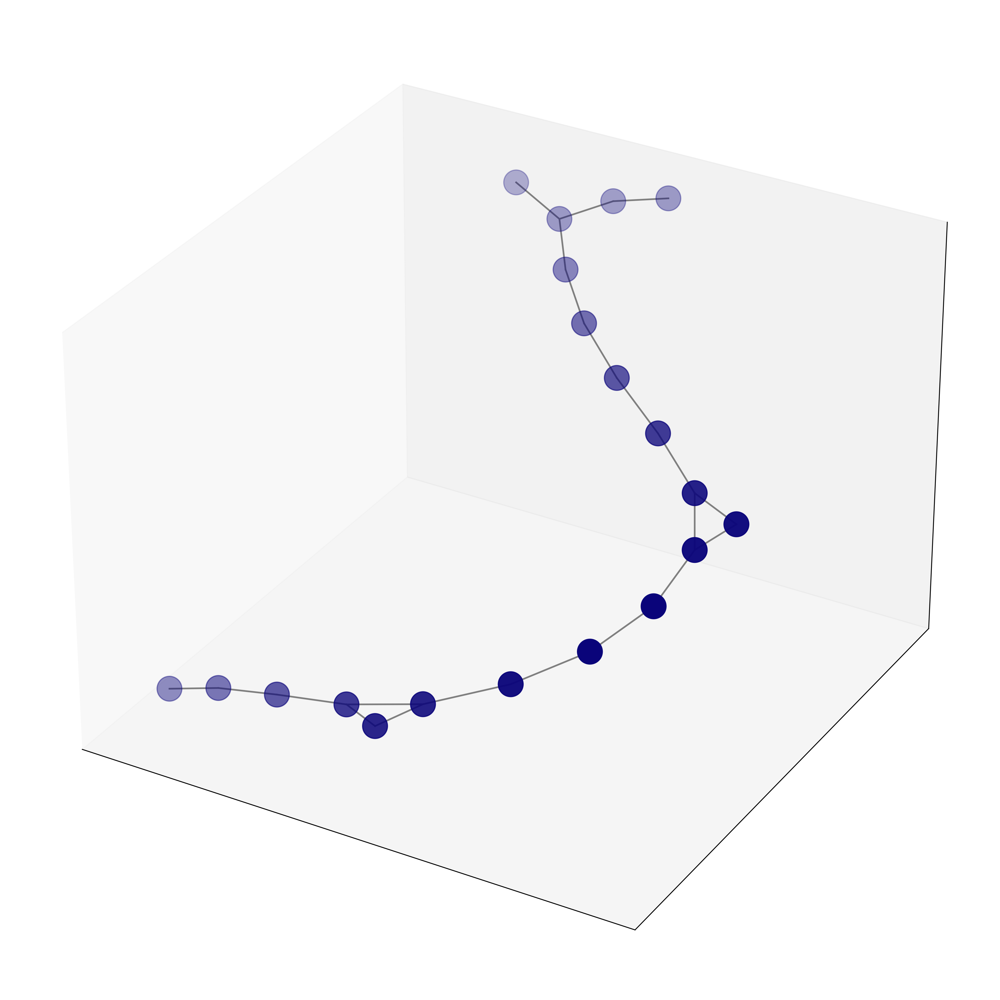

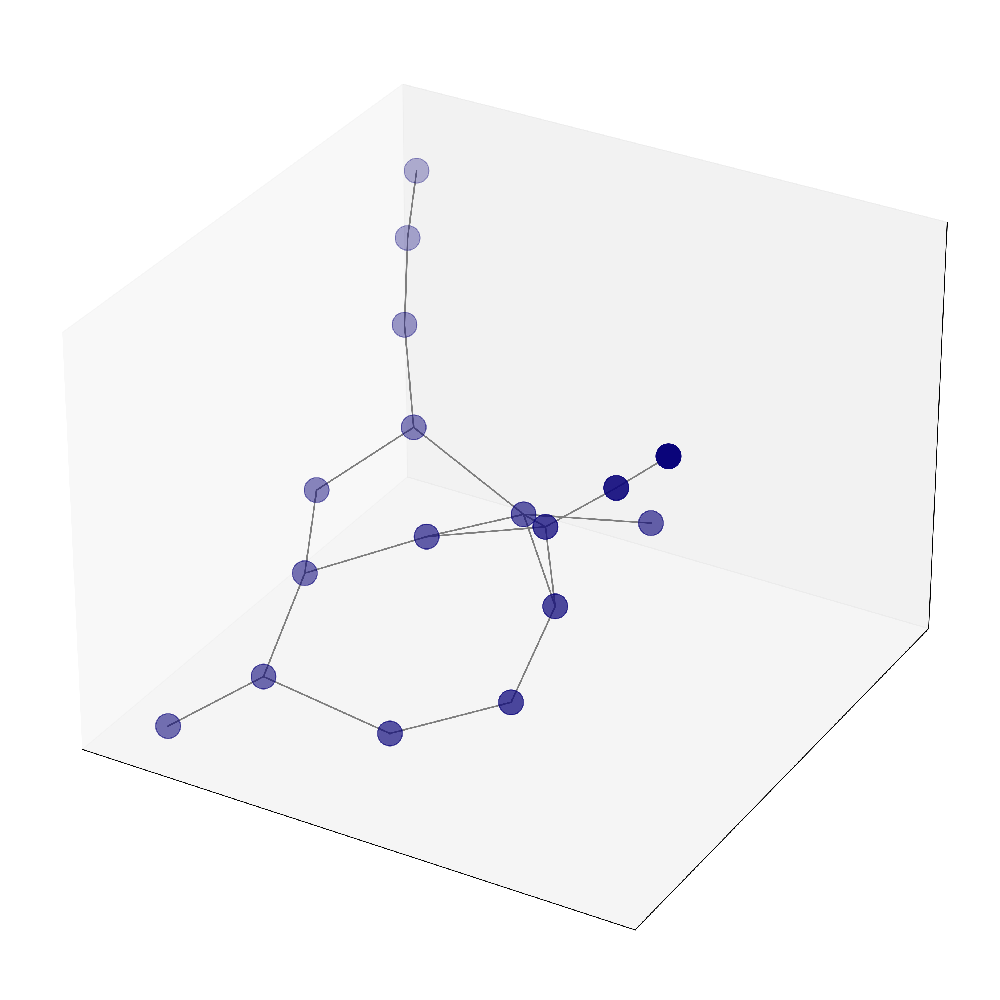

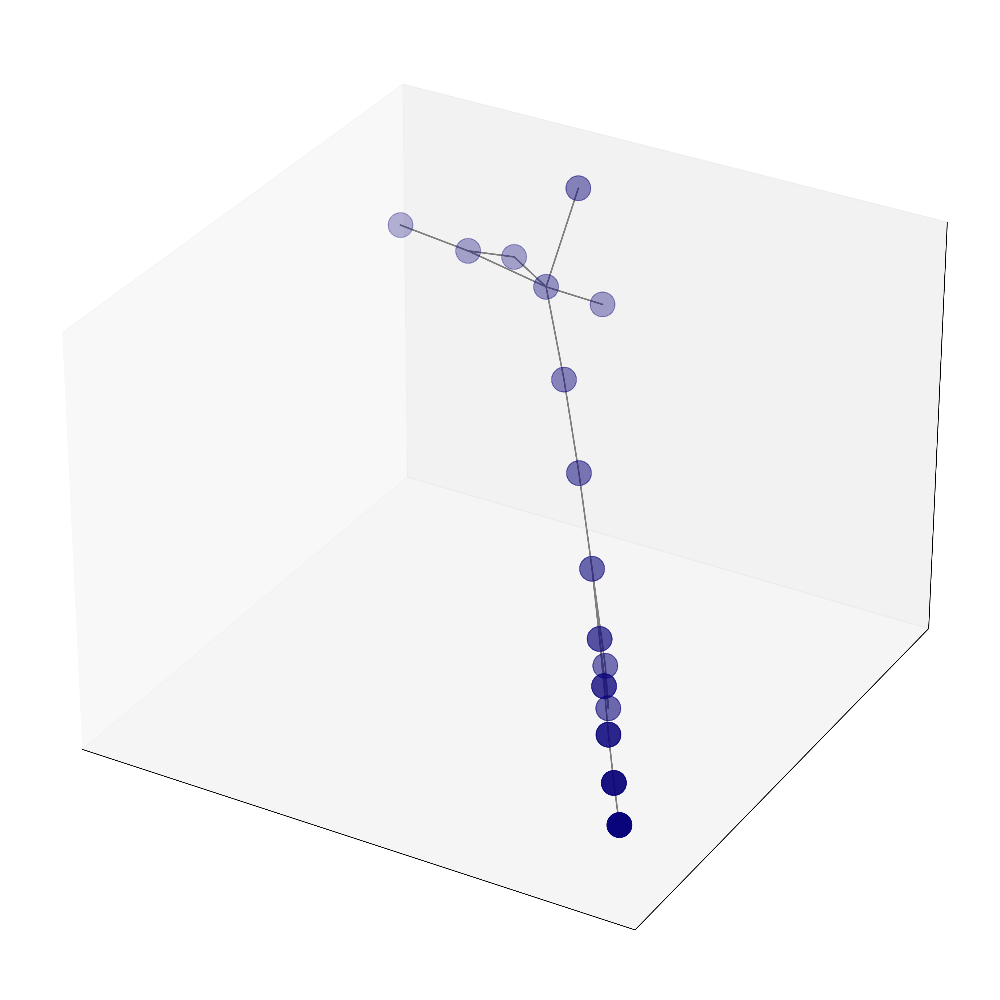

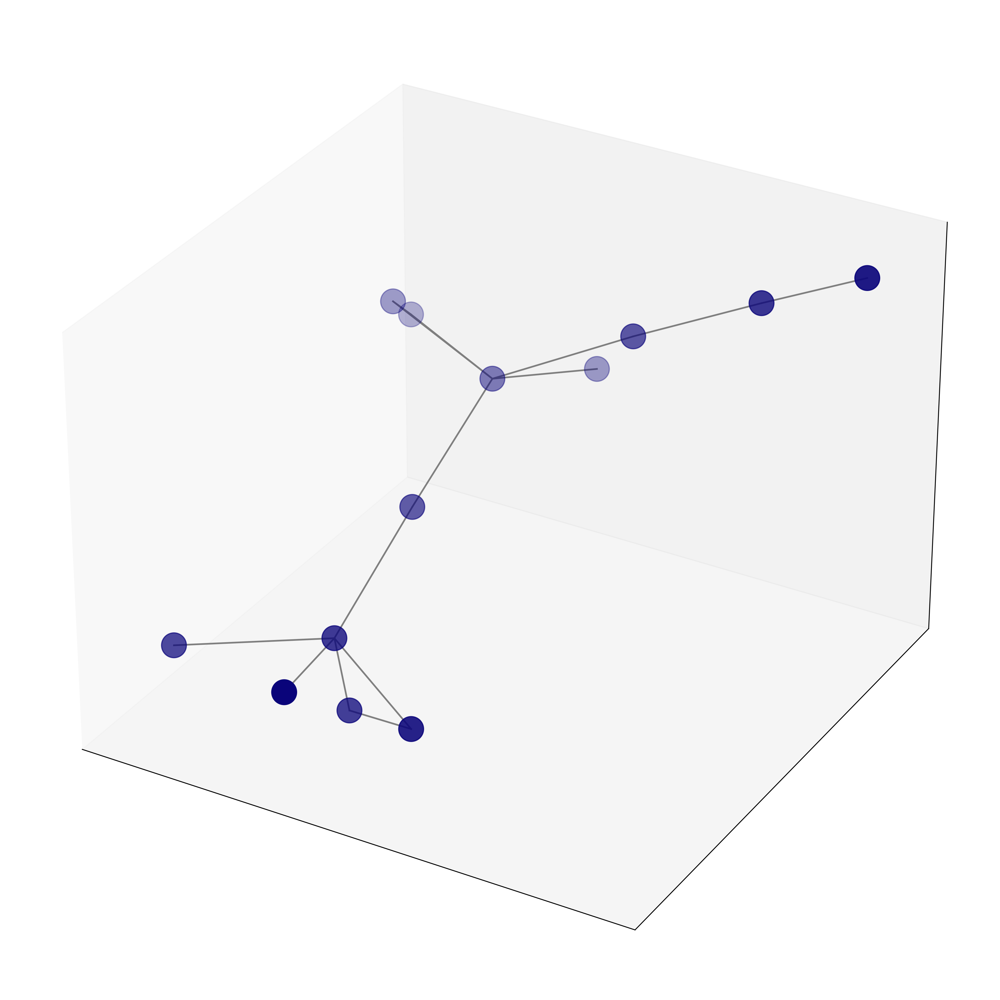

In [18]:
graph_visuals(dataset[0])
graph_visuals(dataset[10000])
graph_visuals(dataset[70023])
graph_visuals(dataset[len(dataset) - 1])

In [19]:
#embeddings testing

import torch
import torch.nn.functional as F
from torch.nn import Sequential, Linear, ReLU, BatchNorm1d
from torch_geometric.nn import GINConv, global_add_pool
import matplotlib.pyplot as plt

class GIN(torch.nn.Module):
    """GIN"""
    def __init__(self, dim_h):
        super(GIN, self).__init__()
        self.conv1 = GINConv(
            Sequential(Linear(dataset.num_node_features, dim_h),
                       BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv2 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv3 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.lin1 = Linear(dim_h*3, dim_h*3)
        self.lin2 = Linear(dim_h*3, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h1 = self.conv1(x, edge_index)
        h2 = self.conv2(h1, edge_index)
        h3 = self.conv3(h2, edge_index)

        # Graph-level readout
        h1 = global_add_pool(h1, batch)
        h2 = global_add_pool(h2, batch)
        h3 = global_add_pool(h3, batch)

        # Concatenate graph embeddings
        h = torch.cat((h1, h2, h3), dim=1)

        # Classifier
        h = self.lin1(h)
        h = h.relu()
        h = F.dropout(h, p=0.5, training=self.training)
        h = self.lin2(h)

        return h, F.log_softmax(h, dim=1)

#gcn = GCN(dim_h=32)
gin = GIN(dim_h=32)

In [ ]:
# training for embedding

In [ ]:
from torch_geometric.loader import DataLoader
# Create training, validation, and test sets
print(dataset[10])
train_dataset = dataset[:int(len(dataset)*0.8)]
val_dataset   = dataset[int(len(dataset)*0.8):int(len(dataset)*0.9)]
test_dataset  = dataset[int(len(dataset)*0.9):]

print(f'Training set   = {len(train_dataset)} graphs')
print(f'Validation set = {len(val_dataset)} graphs')
print(f'Test set       = {len(test_dataset)} graphs')

# Create mini-batches
train_loader = DataLoader(train_dataset, batch_size = 64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

print('\nTrain loader:')
for i, subgraph in enumerate(train_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nValidation loader:')
for i, subgraph in enumerate(val_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nTest loader:')
for i, subgraph in enumerate(test_loader):
    print(f' - Subgraph {i}: {subgraph}')

Data(x=[16, 1], edge_index=[2, 42], y=[1])
Training set   = 64000 graphs
Validation set = 8000 graphs
Test set       = 8000 graphs

Train loader:
 - Subgraph 0: DataBatch(x=[1090, 1], edge_index=[2, 2370], y=[64], batch=[1090], ptr=[65])
 - Subgraph 1: DataBatch(x=[1087, 1], edge_index=[2, 2354], y=[64], batch=[1087], ptr=[65])
 - Subgraph 2: DataBatch(x=[1123, 1], edge_index=[2, 2480], y=[64], batch=[1123], ptr=[65])
 - Subgraph 3: DataBatch(x=[1083, 1], edge_index=[2, 2396], y=[64], batch=[1083], ptr=[65])
 - Subgraph 4: DataBatch(x=[1090, 1], edge_index=[2, 2366], y=[64], batch=[1090], ptr=[65])
 - Subgraph 5: DataBatch(x=[1072, 1], edge_index=[2, 2332], y=[64], batch=[1072], ptr=[65])
 - Subgraph 6: DataBatch(x=[1092, 1], edge_index=[2, 2394], y=[64], batch=[1092], ptr=[65])
 - Subgraph 7: DataBatch(x=[1085, 1], edge_index=[2, 2428], y=[64], batch=[1085], ptr=[65])
 - Subgraph 8: DataBatch(x=[1089, 1], edge_index=[2, 2426], y=[64], batch=[1089], ptr=[65])
 - Subgraph 9: DataBatch(x

In [ ]:
def train(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(),
                                      lr=0.01,
                                      weight_decay=0.01)
    epochs = 1

    model.train()
    for epoch in range(epochs+1):
        #print(epoch)
        total_loss = 0
        acc = 0
        val_loss = 0
        val_acc = 0

        # Train on batches
        for data in loader:
          optimizer.zero_grad()
          _, out = model(data.x, data.edge_index, data.batch)
          loss = criterion(out, data.y)
          total_loss += loss / len(loader)
          acc += accuracy(out.argmax(dim=1), data.y) / len(loader)
          loss.backward()
          optimizer.step()

          # Validation
          val_loss, val_acc = test(model, val_loader)

          # print per epoch to see if the accuracy goes up!
        print(f'Epoch {epoch:>0} | Train Loss: {total_loss:.2f} '
            f'| Train Acc: {acc*100:>5.2f}% '
            f'| Val Loss: {val_loss:.2f} '
            f'| Val Acc: {val_acc*100:.2f}%')


    test_loss, test_acc = test(model, test_loader)
    print(f'Test Loss: {test_loss:.2f} | Test Acc: {test_acc*100:.2f}%')

    return model

@torch.no_grad()
def test(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    model.eval()
    loss = 0
    acc = 0

    for data in loader:
        _, out = model(data.x, data.edge_index, data.batch)
        loss += criterion(out, data.y) / len(loader)
        acc += accuracy(out.argmax(dim=1), data.y) / len(loader)

    return loss, acc

def accuracy(pred_y, y):
    """Calculate accuracy."""
    return ((pred_y == y).sum() / len(y)).item()

#gcn = train(gcn, train_loader)
gin = train(gin, train_loader)

Epoch 0 | Train Loss: 1.40 | Train Acc: 24.92% | Val Loss: 1.39 | Val Acc: 26.16%
Epoch 1 | Train Loss: 1.39 | Train Acc: 25.08% | Val Loss: 1.39 | Val Acc: 25.30%
Test Loss: 1.39 | Test Acc: 24.77%


In [ ]:
#this is to temporarily store the original data:
saving = dataset
print(len(saving))

80000


In [ ]:
tester_reference = np.zeros((21,21))
for chromosome in worklist_adjacency_matrix:
  for graphs in chromosome:
    graphs = graphs.reshape((21,21))
    tester_reference = tester_reference + graphs

tester_reference = tester_reference/80000

for i in range(0, tester_reference.shape[0]):
  for j in range(0, tester_reference.shape[1]):
    if(tester_reference[i][j] > 0.5):
      tester_reference[i][j] = 1
    else:
      tester_reference[i][j] = 0

print(tester_reference)

[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0.

In [ ]:
!pip install scikit-learn


ERROR: Operation cancelled by user


In [ ]:
!pip install umap-learn


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 6.4 MB/s eta 0:00:00


In [ ]:
print(len(selected))

NameError: name 'selected' is not defined

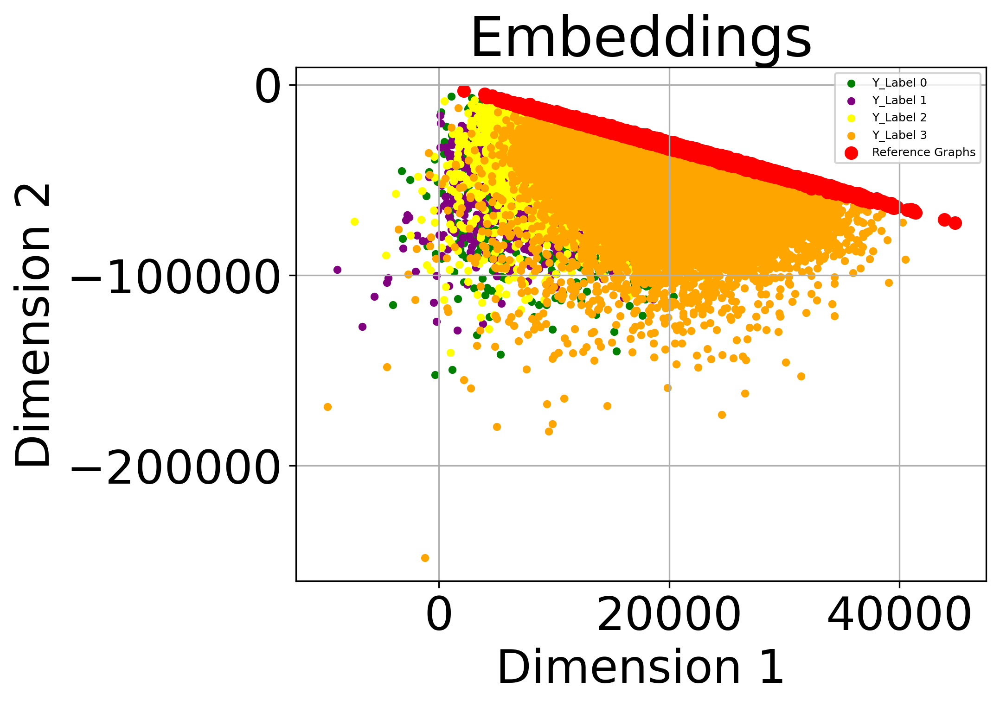

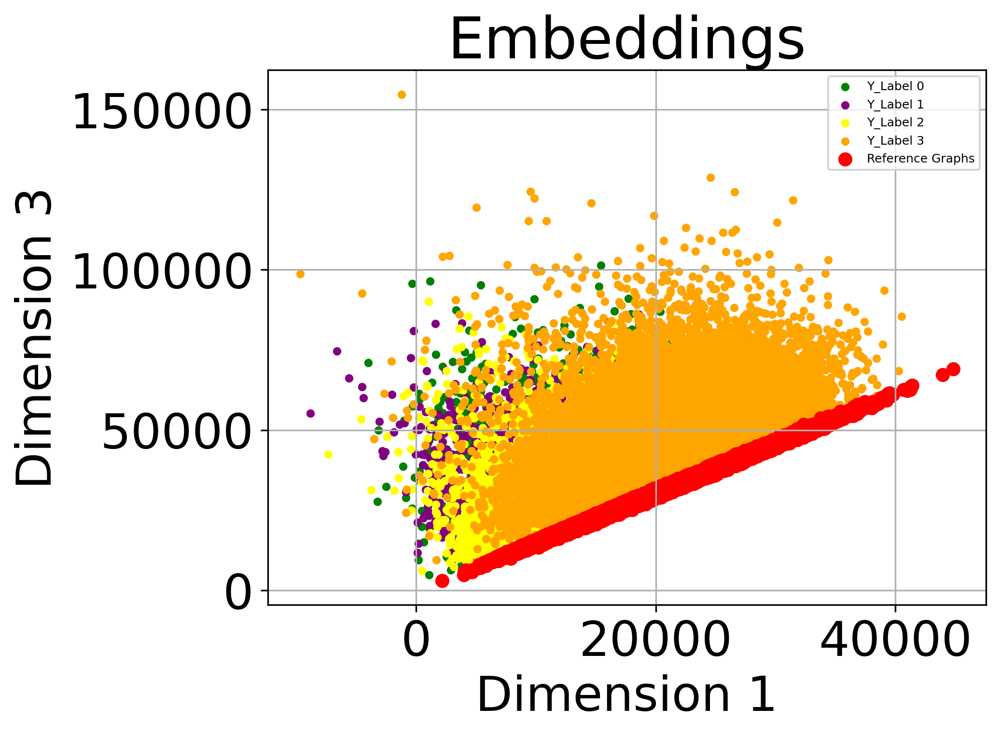

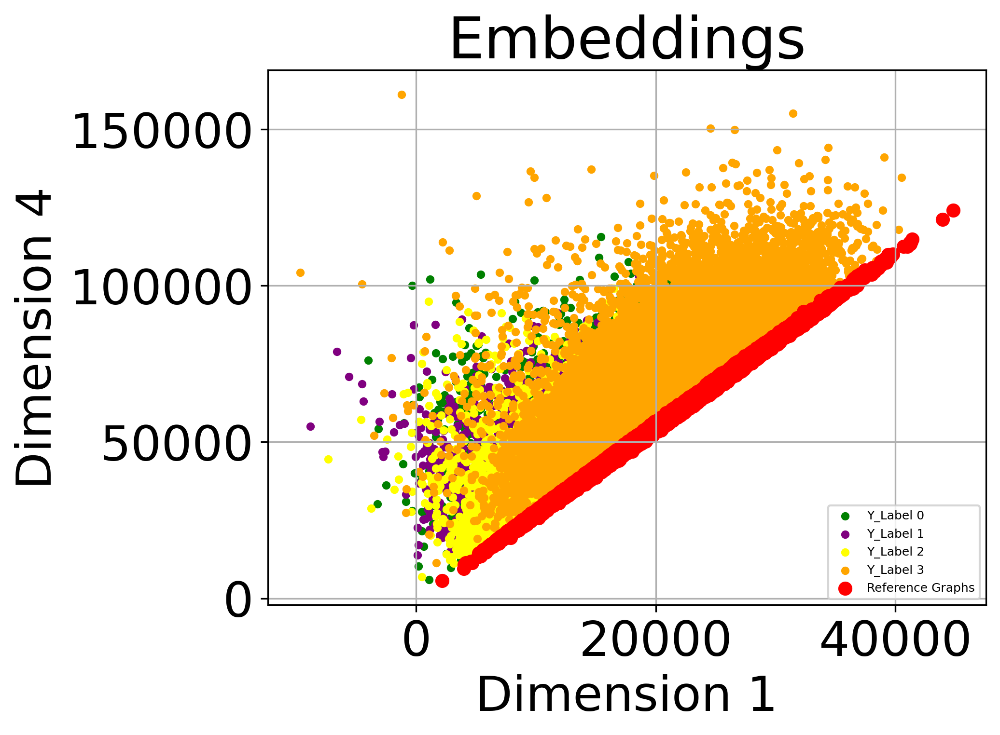

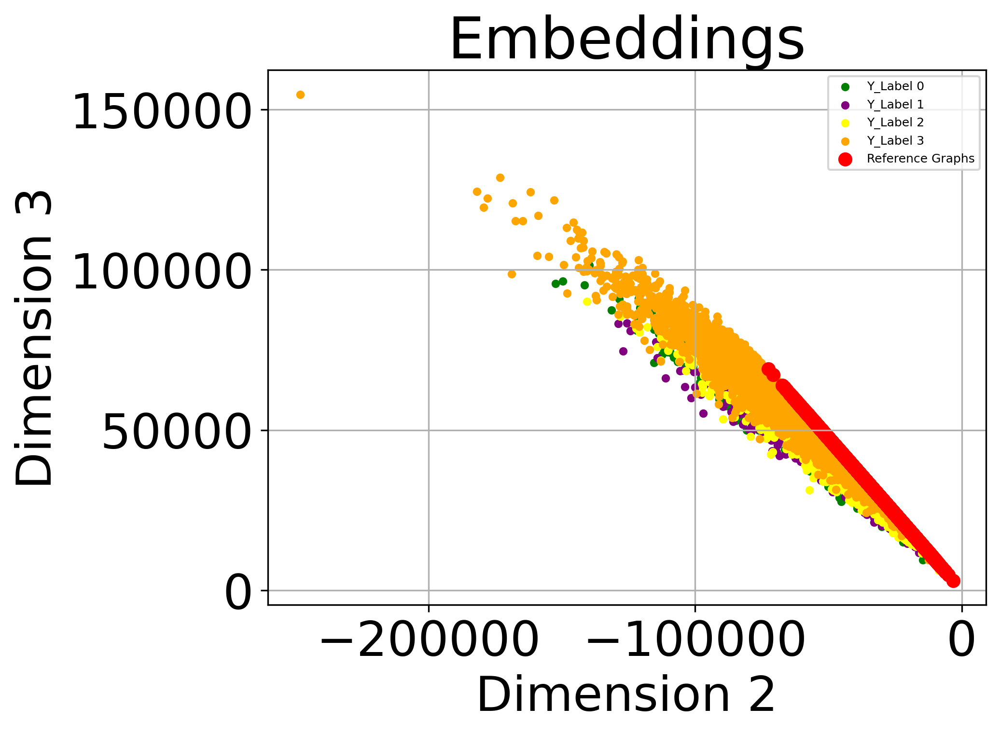

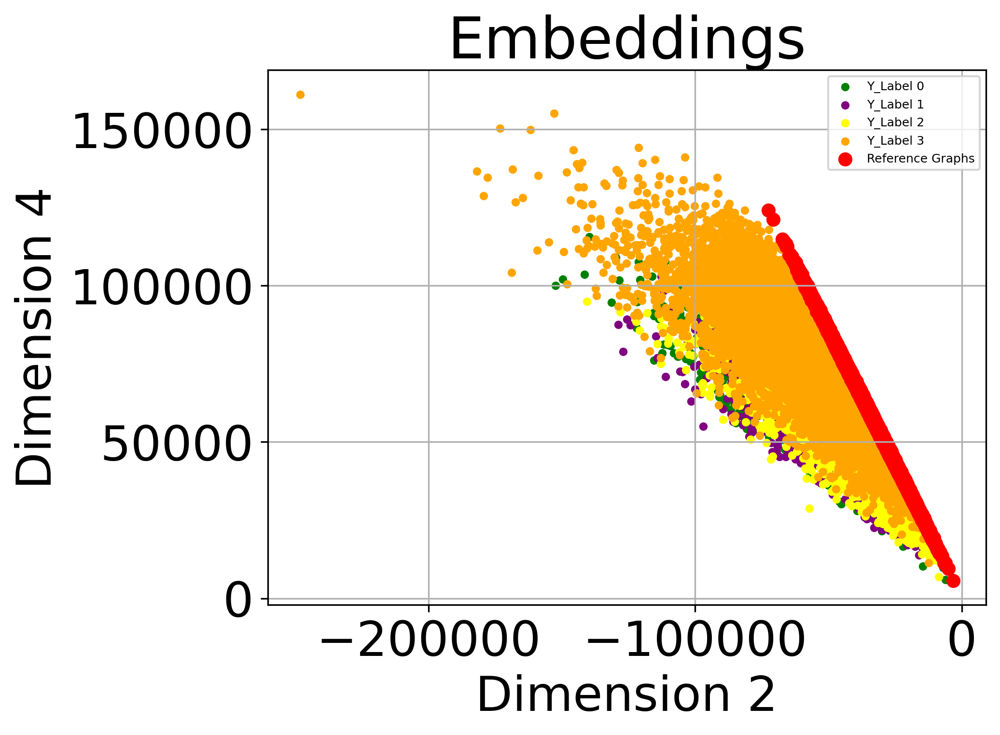

Selected Data: [Data(x=[18, 1], edge_index=[2, 46], y=[1]), Data(x=[15, 1], edge_index=[2, 40], y=[1]), Data(x=[16, 1], edge_index=[2, 44], y=[1]), Data(x=[16, 1], edge_index=[2, 52], y=[1]), Data(x=[17, 1], edge_index=[2, 48], y=[1]), Data(x=[14, 1], edge_index=[2, 40], y=[1]), Data(x=[15, 1], edge_index=[2, 44], y=[1]), Data(x=[16, 1], edge_index=[2, 48], y=[1]), Data(x=[21, 1], edge_index=[2, 54], y=[1]), Data(x=[13, 1], edge_index=[2, 38], y=[1]), Data(x=[16, 1], edge_index=[2, 50], y=[1]), Data(x=[18, 1], edge_index=[2, 52], y=[1]), Data(x=[18, 1], edge_index=[2, 50], y=[1]), Data(x=[18, 1], edge_index=[2, 54], y=[1]), Data(x=[16, 1], edge_index=[2, 44], y=[1]), Data(x=[18, 1], edge_index=[2, 62], y=[1]), Data(x=[21, 1], edge_index=[2, 62], y=[1]), Data(x=[19, 1], edge_index=[2, 60], y=[1]), Data(x=[16, 1], edge_index=[2, 42], y=[1]), Data(x=[16, 1], edge_index=[2, 48], y=[1]), Data(x=[18, 1], edge_index=[2, 52], y=[1]), Data(x=[17, 1], edge_index=[2, 48], y=[1]), Data(x=[15, 1], 

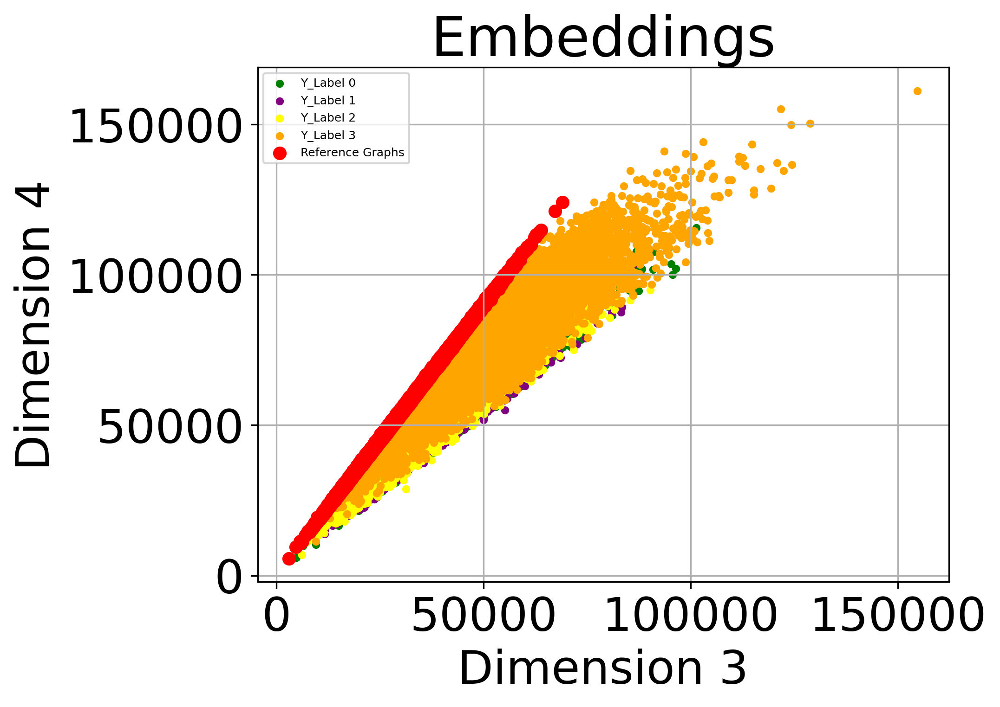

In [ ]:
for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 1],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)


# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 1],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()



for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 2],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)


# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 2],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 3')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()




for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 0],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 0],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()



for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 1],
                embeddings_out[labels[1::2] == label_idx, :, 2],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 1],
                embeddings_out_reference[::2, :, 2],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 2')
plt.ylabel('Dimension 3')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()


for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 1],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 1],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 2')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()

# Process the selected data
print("Selected Data:", selected)

for label_idx in np.unique(labels):
    plt.scatter(embeddings_out[labels[1::2] == label_idx, :, 2],
                embeddings_out[labels[1::2] == label_idx, :, 3],
                color = color_dict[label_idx],
                label=f'Y_Label {label_idx}',
                s = 10)

# Scatter plot for embedding_out (colored by labels)
plt.scatter(embeddings_out_reference[::2, :, 2],
                embeddings_out_reference[::2, :, 3],
                color = 'red',
                label= "Reference Graphs")

plt.title('Embeddings')
plt.xlabel('Dimension 3')
plt.ylabel('Dimension 4')
plt.legend(fontsize = 6)
plt.grid(True)
plt.show()

In [ ]:
dataset = saving
print(len(dataset))

NameError: name 'saving' is not defined

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import torch
import scipy.sparse as sp
from torch_geometric.utils import from_scipy_sparse_matrix
from torch_geometric.data import Data

# Assuming GIN and dataset are defined elsewhere
checking = set()

# Assuming embeddings_out and embeddings_out_reference are numpy arrays
torch.manual_seed(42)
np.random.seed(42)

model = GIN(dim_h=32)  # Replace with your model initialization
model.eval()

threshold_val = 35

# Initialize lists and set to store embeddings
embeddings_list = []
labels_list = []
distance_list = []
dis_label_list = []
selected = []
unique_reference_embeddings = set()  # Set to store unique reference embeddings

for data in dataset:
    new_x = data.x
    new_y = data.y

    # Create a reference graph with edges between consecutive nodes
    reference_graph = np.zeros((len(data.x), len(data.x)))

    for i in range(reference_graph.shape[0] - 1):
        reference_graph[i][i + 1] = 1
        reference_graph[i + 1][i] = 1

    reference_adj = sp.coo_matrix(reference_graph)
    edge_index, edge_attr = from_scipy_sparse_matrix(reference_adj)
    data_reference = Data(x=new_x, edge_index=edge_index, y=new_y)

    with torch.no_grad():
        # Get embeddings from the model
        embedding_out, _ = model(data.x, data.edge_index, data.batch)
        checking.add(torch.max(data.x).item())
        embedding_out_reference, _ = model(data_reference.x, data_reference.edge_index, data.batch)

    # Convert embeddings to numpy arrays and detach from gradient computation
    out_tensor = embedding_out.detach().numpy()
    reference_out_tensor = embedding_out_reference.detach().numpy()

    # Append embeddings and labels to lists
    embeddings_list.append(out_tensor)
    embeddings_list.append(reference_out_tensor)
    labels_list.append(data.y.numpy())
    labels_list.append(data_reference.y.numpy())

    # Calculate Euclidean distance and select based on threshold
    e_dis = np.linalg.norm(out_tensor - reference_out_tensor)
    if e_dis >= threshold_val:
        selected.append(data)
        sampling = np.array(out_tensor)
        distance_list.append(sampling)
        dis_label_list.append(data.y.numpy())

    # Collect unique embeddings from embedding_out_reference
    for emb in reference_out_tensor:
        unique_reference_embeddings.add(tuple(emb))

# Convert lists to numpy arrays for plotting
measure = np.array(distance_list)
embeddings = np.array(embeddings_list)
labels = np.hstack(labels_list)
dis_labels = np.hstack(dis_label_list)

# Convert set of unique reference embeddings back to numpy array
unique_reference_embeddings = np.array(list(unique_reference_embeddings))

# Now unique_reference_embeddings contains all unique embeddings from embedding_out_reference



In [20]:
print(checking)
print(len(checking))

{3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0}
18


In [21]:
print(len(unique_reference_embeddings))
print(unique_reference_embeddings)

18
[[  6.8028674  -10.619545     9.27918     18.808344  ]
 [  2.7415428   -4.074395     3.3761284    7.4796433 ]
 [  8.559785   -13.488121    11.900021    23.72696   ]
 [  6.0000124   -9.31407      8.09124     16.56322   ]
 [ 10.518321   -16.700165    14.847472    29.216719  ]
 [  0.73508847  -0.9812968    0.7077494    1.9591225 ]
 [  0.29596445  -0.34180832   0.20813718   0.7468051 ]
 [  1.3900254   -1.960687     1.5257556    3.7417872 ]
 [  9.513853   -15.0512085   13.332921    26.400444  ]
 [  7.6561284  -12.0109      10.548776    21.196262  ]
 [  4.545514    -6.9607086    5.9603114   12.501316  ]
 [  3.2925344   -4.9507155    4.155925     9.010663  ]
 [  5.2475634   -8.094455     6.984949    14.460871  ]
 [  0.4893058   -0.6151016    0.4161082    1.2848518 ]
 [  1.037337    -1.4271526    1.0764642    2.7789829 ]
 [  3.8938694   -5.9128327    5.0173264   10.684541  ]
 [  2.240955    -3.2839444    2.677985     6.0914116 ]
 [  1.7906654   -2.5794568    2.0611722    4.8455873 ]]


In [ ]:
#PERFORM THE NEXT CODE BLOCK

In [ ]:
!sudo apt-get install build-essential libboost-program-options-dev libboost-python-dev python3-dev


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
build-essential is already the newest version (12.9ubuntu3).
libboost-program-options-dev is already the newest version (1.74.0.3ubuntu7).
libboost-python-dev is already the newest version (1.74.0.3ubuntu7).
python3-dev is already the newest version (3.10.6-1~22.04).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [ ]:
!pip install LargeVis

In [ ]:
!pip install scanpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.4/124.4 kB 12.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 7.5 MB/s eta 0:00:00
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8026 sha256=e4c90110ba67616a9472b95238cecffd19c4f2f0445d6c417e3e263523a62021
  Stored in directory: /root/.cache/pip/wheels/6a/aa/b9/eb5d4031476ec10802795b97ccf937b9bd998d68a9b268765a
Successfully built session-info


In [ ]:
!pip install openTSNE

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 8.9 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# This snippet of code is a test!!!!

# Example embeddings and labels (replace with your actual data)

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
})


# Measure data
df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
})

# Embeddings data
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})


# Combine only the reference data into one DataFrame
df_all = df_reference.copy()

# Perform t-SNE to reduce to 3 dimensions
tsne_reducer = TSNE(n_components=3, perplexity=30, learning_rate=200, n_iter=1000, random_state=42)
tsne_result = tsne_reducer.fit_transform(df_all[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

df_all['TSNE1'] = tsne_result[:, 0]
df_all['TSNE2'] = tsne_result[:, 1]
df_all['TSNE3'] = tsne_result[:, 2]

# Assign color to the reference label
df_all['Color'] = 'red'

# Extract unique embeddings
unique_embeddings = df_all[['Dim1', 'Dim2', 'Dim3', 'Dim4']].drop_duplicates()

# Create the 3D scatter plot for unique embeddings
fig = go.Figure()

# Add unique embeddings
fig.add_trace(
    go.Scatter3d(
        x=unique_embeddings['Dim1'],
        y=unique_embeddings['Dim2'],
        z=unique_embeddings['Dim3'],
        mode='markers',
        marker=dict(
            size=5,
            color='red'  # Set color as per your preference
        ),
        name='Reference Graphs'
    )
)

# Update layout
fig.update_layout(
    title='3D t-SNE Visualization of Unique Embeddings',
    scene=dict(
        xaxis_title='Dim1',
        yaxis_title='Dim2',
        zaxis_title='Dim3'
    )
)

fig.show()






print(f'Number of Unique Embeddings: {len(unique_embeddings)}')
print(unique_embeddings)

Number of Unique Embeddings: 18
            Dim1       Dim2       Dim3       Dim4
0       9.513853 -15.051208  13.332921  26.400444
1       7.656128 -12.010900  10.548776  21.196262
2       6.802867 -10.619545   9.279180  18.808344
3       5.247563  -8.094455   6.984949  14.460871
10      3.292534  -4.950716   4.155925   9.010663
14      8.559785 -13.488121  11.900021  23.726959
16      4.545514  -6.960709   5.960311  12.501316
23      6.000012  -9.314070   8.091240  16.563219
115     3.893869  -5.912833   5.017326  10.684541
141    10.518321 -16.700165  14.847472  29.216719
372     2.741543  -4.074395   3.376128   7.479643
987     1.790665  -2.579457   2.061172   4.845587
2472    1.390025  -1.960687   1.525756   3.741787
2678    0.489306  -0.615102   0.416108   1.284852
3096    2.240955  -3.283944   2.677985   6.091412
5037    1.037337  -1.427153   1.076464   2.778983
10035   0.295964  -0.341808   0.208137   0.746805
51890   0.735088  -0.981297   0.707749   1.959123


In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go


# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
})

# Measure data
df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
})

# Embeddings data
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Function to process and plot unique embeddings with t-SNE
def plot_unique_embeddings(df, label, color):
    # Perform t-SNE to reduce to 3 dimensions
    tsne_reducer = TSNE(n_components=3, perplexity=30, learning_rate=200, n_iter=1000, random_state=42)
    tsne_result = tsne_reducer.fit_transform(df[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

    df['TSNE1'] = tsne_result[:, 0]
    df['TSNE2'] = tsne_result[:, 1]
    df['TSNE3'] = tsne_result[:, 2]

    # Assign color to the label
    df['Color'] = color

    # Extract unique embeddings
    unique_embeddings = df[['Dim1', 'Dim2', 'Dim3', 'Dim4']].drop_duplicates()

    # Create the 3D scatter plot for unique embeddings
    fig = go.Figure()

    # Add unique embeddings
    fig.add_trace(
        go.Scatter3d(
            x=unique_embeddings['Dim1'],
            y=unique_embeddings['Dim2'],
            z=unique_embeddings['Dim3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color  # Set color as per your preference
            ),
            name=f'{label} Graphs'
        )
    )

    # Update layout
    fig.update_layout(
        title=f'3D t-SNE Visualization of Unique {label} Embeddings',
        scene=dict(
            xaxis_title='Dim1',
            yaxis_title='Dim2',
            zaxis_title='Dim3'
        )
    )

    fig.show()
    print(f'Number of Unique {label} Embeddings: {len(unique_embeddings)}')
    print(unique_embeddings)

# Plot unique embeddings for each DataFrame
plot_unique_embeddings(df_reference, 'Reference', 'red')
plot_unique_embeddings(df_measure, 'Measure', 'blue')
plot_unique_embeddings(df_embeddings, 'Embeddings', 'green')



Number of Unique Reference Embeddings: 18
            Dim1       Dim2       Dim3       Dim4
0       7.656128 -12.010900  10.548776  21.196262
1       5.247563  -8.094455   6.984949  14.460871
2       8.559785 -13.488121  11.900021  23.726959
4       6.802867 -10.619545   9.279180  18.808344
22      9.513853 -15.051208  13.332921  26.400444
30      6.000012  -9.314070   8.091240  16.563219
40      4.545514  -6.960709   5.960311  12.501316
41      3.893869  -5.912833   5.017326  10.684541
51      2.741543  -4.074395   3.376128   7.479643
169     2.240955  -3.283944   2.677985   6.091412
236     3.292534  -4.950716   4.155925   9.010663
291    10.518321 -16.700165  14.847472  29.216719
443     1.390025  -1.960687   1.525756   3.741787
479     1.790665  -2.579457   2.061172   4.845587
935     1.037337  -1.427153   1.076464   2.778983
1194    0.489306  -0.615102   0.416108   1.284852
39346   0.295964  -0.341808   0.208137   0.746805
72841   0.735088  -0.981297   0.707749   1.959123


In [ ]:
plot_unique_embeddings(df_measure, 'Measure', 'blue')
plot_unique_embeddings(df_embeddings, 'Embeddings', 'green')

Number of Unique Measure Embeddings: 110
         Dim1       Dim2       Dim3       Dim4
0    5.186223 -44.553642  31.244881  37.528843
1    2.001782 -47.857250  30.917332  35.509315
2    3.060118 -52.009975  34.570824  39.861263
3    4.580208 -44.642334  30.898670  36.659611
4    4.524440 -43.969864  30.329899  36.222370
..        ...        ...        ...        ...
105  0.537535 -44.980728  27.404667  30.137527
106  1.500898 -42.646935  26.985405  30.229750
107  1.899190 -45.915756  29.380362  33.374619
108  1.228169 -50.642315  32.014763  35.917023
109  1.153567 -50.138199  31.033712  34.033413

[110 rows x 4 columns]


Number of Unique Embeddings Embeddings: 75040
           Dim1       Dim2       Dim3       Dim4
0      6.033003 -18.653135  15.020862  23.219954
1      3.660570 -18.328297  13.523159  18.499924
2      7.277072 -22.344563  18.328634  28.225906
3      6.607439 -16.356588  13.844530  23.161545
4      5.948603 -11.662678  10.106196  18.660496
...         ...        ...        ...        ...
79994  5.400564 -14.495090  12.025126  19.955891
79995  6.735639 -15.833822  13.501704  22.973295
79996  8.380110 -20.947887  17.859552  29.486055
79997  7.756230 -18.124878  15.545122  26.327497
79999  5.199270 -11.726789   9.900707  17.369265

[75040 rows x 4 columns]


In [30]:
!pip install MulticoreTSNE

  Using cached MulticoreTSNE-0.1.tar.gz (20 kB)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for MulticoreTSNE
  Running setup.py clean for MulticoreTSNE
Failed to build MulticoreTSNE
ERROR: Could not build wheels for MulticoreTSNE, which is required to install pyproject.toml-based projects


In [24]:
# this code is for 2 dimetional view
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Function to sample data
def sample_data(df, sample_size):
    return df.sample(n=sample_size, random_state=42)

# Sample size
sample_size = 14000  # Adjust this based on your memory constraints

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
})

# Measure data
df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
})

# Embeddings data
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Extract unique embeddings from each DataFrame
unique_reference = df_reference[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates()
unique_measure = df_measure[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates()
unique_embeddings = sample_data(df_embeddings[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates(), sample_size)

# Check types of the unique embeddings
print(type(unique_reference))  # Should print: <class 'pandas.core.frame.DataFrame'>
print(type(unique_measure))    # Should print: <class 'pandas.core.frame.DataFrame'>
print(type(unique_embeddings)) # Should print: <class 'pandas.core.frame.DataFrame'>

# Combine unique embeddings
combined_df = pd.concat([unique_reference, unique_measure, unique_embeddings])

# Perform t-SNE to reduce to 2 dimensions
tsne_reducer = TSNE(n_components=2, perplexity=7000, learning_rate=400, n_iter=1000, random_state=42)
tsne_result = tsne_reducer.fit_transform(combined_df[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

combined_df['TSNE1'] = tsne_result[:, 0]
combined_df['TSNE2'] = tsne_result[:, 1]

# Plot the combined unique embeddings
fig = px.scatter(
    combined_df,
    x='TSNE1',
    y='TSNE2',
    color='Label',
    title='2D t-SNE Visualization of Unique Embeddings',
    labels={'TSNE1': 't-SNE Dimension 1', 'TSNE2': 't-SNE Dimension 2'}
)

fig.show()


<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [25]:
# This is the code for the 3 dimensional case
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Function to sample data
def sample_data(df, sample_size):
    return df.sample(n=sample_size, random_state=42)

# Sample size
sample_size = 14000  # Adjust this based on your memory constraints

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
})

# Measure data
df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
})

# Embeddings data
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
})

# Extract unique embeddings from each DataFrame
unique_reference = df_reference[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates()
unique_measure = df_measure[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates()
unique_embeddings = sample_data(df_embeddings[['Dim1', 'Dim2', 'Dim3', 'Dim4', 'Label']].drop_duplicates(), sample_size)

# Check types of the unique embeddings
print(type(unique_reference))  # Should print: <class 'pandas.core.frame.DataFrame'>
print(type(unique_measure))    # Should print: <class 'pandas.core.frame.DataFrame'>
print(type(unique_embeddings)) # Should print: <class 'pandas.core.frame.DataFrame'>

# Combine unique embeddings
combined_df = pd.concat([unique_reference, unique_measure, unique_embeddings])

# Perform t-SNE to reduce to 3 dimensions
tsne_reducer = TSNE(n_components=3, perplexity=7000, learning_rate=400, n_iter=1000, random_state=42)
tsne_result = tsne_reducer.fit_transform(combined_df[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

combined_df['TSNE1'] = tsne_result[:, 0]
combined_df['TSNE2'] = tsne_result[:, 1]
combined_df['TSNE3'] = tsne_result[:, 2]

# Plot the combined unique embeddings
fig = px.scatter_3d(
    combined_df,
    x='TSNE1',
    y='TSNE2',
    z='TSNE3',
    color='Label',
    title='3D t-SNE Visualization of Unique Embeddings',
    labels={'TSNE1': 't-SNE Dimension 1', 'TSNE2': 't-SNE Dimension 2', 'TSNE3': 't-SNE Dimension 3'}
)

fig.show()



<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
}).drop_duplicates()

df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
}).drop_duplicates()

df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
}).drop_duplicates()

# Concatenate all dataframes
df_combined = pd.concat([df_reference, df_measure, df_embeddings])

# Function to process and plot unique embeddings with t-SNE
def tsne_transform(df, default_perplexity=30):
    # Adjust perplexity to be less than the number of samples
    perplexity = min(len(df) - 1, default_perplexity)

    tsne_reducer = TSNE(n_components=3, perplexity=perplexity, learning_rate=200, n_iter=1000, random_state=42)
    tsne_result = tsne_reducer.fit_transform(df[['Dim1', 'Dim2', 'Dim3', 'Dim4']])
    df['TSNE1'] = tsne_result[:, 0]
    df['TSNE2'] = tsne_result[:, 1]
    df['TSNE3'] = tsne_result[:, 2]
    return df

# Perform t-SNE transformation on the combined dataframe
df_combined_tsne = tsne_transform(df_combined)

# Create the 3D scatter plot for unique embeddings
fig = go.Figure()

# Add unique embeddings to the figure based on labels
labels_colors = {
    'Reference': 'red',
    'Measure': 'blue',
    'Embeddings': 'green'
}

def add_trace(fig, df, label, color):
    unique_embeddings = df[['TSNE1', 'TSNE2', 'TSNE3']]
    fig.add_trace(
        go.Scatter3d(
            x=unique_embeddings['TSNE1'],
            y=unique_embeddings['TSNE2'],
            z=unique_embeddings['TSNE3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color  # Set color as per your preference
            ),
            name=f'{label} Graphs'
        )
    )
    print(f'Number of Unique {label} Embeddings: {len(unique_embeddings)}')
    print(unique_embeddings)

for label, color in labels_colors.items():
    df_label = df_combined_tsne[df_combined_tsne['Label'] == label]
    add_trace(fig, df_label, label, color)

# Update layout
fig.update_layout(
    title='3D t-SNE Visualization of Unique Embeddings',
    scene=dict(
        xaxis_title='TSNE1',
        yaxis_title='TSNE2',
        zaxis_title='TSNE3'
    )
)

# Show the figure
fig.show()



KeyboardInterrupt: 

Number of Unique Reference Embeddings: 37
           TSNE1      TSNE2      TSNE3
0     -11.214900   8.316674   7.016963
1      -1.919972  -8.539968   2.154004
2      62.217979  40.821205  20.272535
3      10.763036  -9.391062  -3.550062
4       6.404490   4.858388   2.595602
6      -1.919924  -8.537387   2.158134
10     14.111968  17.052025   1.690093
14     -0.076494 -48.663036  -0.608945
16     20.440098   3.418169  -0.934105
23     -4.696738   7.546656  -6.956339
32     10.759571  -9.396994  -3.546547
36    -11.214664   8.316721   7.018005
115    20.072979  -7.434948   5.604394
141    -2.776054  18.003326   5.042463
199     6.490252   2.973907  -3.163757
269    -1.569486  -6.416107  -3.682113
347     6.729980   5.271128   3.159874
372    13.803417   6.356567 -11.788409
385    -2.649553   2.201256  -7.418330
469   -10.321946 -19.367758  -3.830634
481    -2.015491  -9.228245   2.486012
538     7.883324  -6.315614  -4.381184
586    -4.932047   7.997674  -7.535044
601   -15.694133  -3.6

In [ ]:
!pip install umap-learn

In [ ]:
import pandas as pd
import numpy as np
import umap
import plotly.graph_objects as go

# Assuming embeddings, labels, and measure are already defined

# Example embeddings and labels (replace with your actual data)

# Combine all data into a single DataFrame with an indicator column
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
}).drop_duplicates()

# Measure data
df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
}).drop_duplicates()

# Embeddings data
df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
}).drop_duplicates()

# Function to plot UMAP for each dataset with different colors for each label
def plot_umap_3d(df, name, label_colors):

    umap_reducer = umap.UMAP(n_components=3, random_state=42, metric='euclidean', n_neighbors=2, min_dist=0.005)
    umap_result = umap_reducer.fit_transform(df[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

    df['UMAP1'] = umap_result[:, 0]
    df['UMAP2'] = umap_result[:, 1]
    df['UMAP3'] = umap_result[:, 2]

    # Drop duplicates to plot unique embeddings
    unique_embeddings = df[['UMAP1', 'UMAP2', 'UMAP3', 'Label']]
    print(len(unique_embeddings))

    # Create 3D scatter plot
    for label in unique_embeddings['Label'].unique():
        subset = unique_embeddings[unique_embeddings['Label'] == label]
        color = label_colors[label]
        fig.add_trace(
            go.Scatter3d(
                x=subset['UMAP1'],
                y=subset['UMAP2'],
                z=subset['UMAP3'],
                mode='markers',
                marker=dict(
                    size=5,
                    color=color  # Set color based on label
                ),
                name=f'{name} - {label}'
            )
        )

# Initialize Figure
fig = go.Figure()

# Define label colors
label_colors_measure = {label: 'rgb({},{},{})'.format(*np.random.randint(0, 255, 3)) for label in np.unique(dis_labels)}
label_colors_embeddings = {label: 'rgb({},{},{})'.format(*np.random.randint(0, 255, 3)) for label in np.unique(labels)}

# Plot UMAP for each DataFrame separately
plot_umap_3d(df_reference, 'Reference', {'Reference': 'red'})
plot_umap_3d(df_measure, 'Measure', label_colors_measure)
plot_umap_3d(df_embeddings, 'Embeddings', label_colors_embeddings)

# Update layout
fig.update_layout(
    title='3D UMAP Visualization of Unique Embeddings',
    scene=dict(
        xaxis_title='UMAP1',
        yaxis_title='UMAP2',
        zaxis_title='UMAP3'
    )
)

fig.show()



NameError: name 'embeddings' is not defined

In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# Assuming embeddings, labels, and measure are already defined

# Create DataFrames for each group of embeddings
df_reference = pd.DataFrame({
    'Dim1': embeddings[1::2, :, 0].flatten(),
    'Dim2': embeddings[1::2, :, 1].flatten(),
    'Dim3': embeddings[1::2, :, 2].flatten(),
    'Dim4': embeddings[1::2, :, 3].flatten(),
    'Label': 'Reference'
}).drop_duplicates()

print(len(df_reference))
print(df_reference)

df_measure = pd.DataFrame({
    'Dim1': measure[:, :, 0].flatten(),
    'Dim2': measure[:, :, 1].flatten(),
    'Dim3': measure[:, :, 2].flatten(),
    'Dim4': measure[:, :, 3].flatten(),
    'Label': dis_labels[:].repeat(embeddings.shape[1])
}).drop_duplicates()

df_embeddings = pd.DataFrame({
    'Dim1': embeddings[::2, :, 0].flatten(),
    'Dim2': embeddings[::2, :, 1].flatten(),
    'Dim3': embeddings[::2, :, 2].flatten(),
    'Dim4': embeddings[::2, :, 3].flatten(),
    'Label': labels[::2].repeat(embeddings.shape[1])
}).drop_duplicates()

# Combine all unique data into one DataFrame
df_all = pd.concat([df_reference, df_measure, df_embeddings], ignore_index=True)

# Perform t-SNE to reduce to 3 dimensions
tsne_reducer = TSNE(n_components=3, perplexity=30, learning_rate=200, n_iter=1000, random_state=42)
tsne_result = tsne_reducer.fit_transform(df_all[['Dim1', 'Dim2', 'Dim3', 'Dim4']])

# Add t-SNE results to the DataFrame
df_all['TSNE1'] = tsne_result[:, 0]
df_all['TSNE2'] = tsne_result[:, 1]
df_all['TSNE3'] = tsne_result[:, 2]

# Assign simple colors to each label
color_dict = {0: 'green', 1: 'purple', 2: 'yellow', 3: 'orange', 'Reference': 'red', 'Measure': 'blue'}
df_all['Color'] = df_all['Label'].map(color_dict)

# Create the 3D scatter plot
fig = go.Figure()

# Add reference data
fig.add_trace(
    go.Scatter3d(
        x=df_all[df_all['Label'] == 'Reference']['TSNE1'],
        y=df_all[df_all['Label'] == 'Reference']['TSNE2'],
        z=df_all[df_all['Label'] == 'Reference']['TSNE3'],
        mode='markers',
        marker=dict(
            size=5,
            color='red'
        ),
        name='Embeddings Out Reference'
    )
)


# Add measure data
for label in df_measure['Label'].unique():
    fig.add_trace(
        go.Scatter3d(
            x=df_all[df_all['Label'] == label]['TSNE1'],
            y=df_all[df_all['Label'] == label]['TSNE2'],
            z=df_all[df_all['Label'] == label]['TSNE3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color_dict[label]
            ),
            name=f'Embeddings Measure Reference {label}'
        )
    )

# Add embeddings data
for label in df_embeddings['Label'].unique():
    fig.add_trace(
        go.Scatter3d(
            x=df_all[df_all['Label'] == label]['TSNE1'],
            y=df_all[df_all['Label'] == label]['TSNE2'],
            z=df_all[df_all['Label'] == label]['TSNE3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color_dict[label]
            ),
            name=f'Embeddings Out Label {label}'
        )
    )

# Update layout
fig.update_layout(
    title='3D t-SNE Visualization of Embeddings',
    scene=dict(
        xaxis_title='TSNE1',
        yaxis_title='TSNE2',
        zaxis_title='TSNE3'
    )
)

fig.show()



18
            Dim1       Dim2       Dim3       Dim4      Label
0       6.802867 -10.619545   9.279180  18.808344  Reference
1       8.559785 -13.488121  11.900021  23.726959  Reference
2       6.000012  -9.314070   8.091240  16.563219  Reference
3       7.656128 -12.010900  10.548776  21.196262  Reference
4       4.545514  -6.960709   5.960311  12.501316  Reference
10      3.893869  -5.912833   5.017326  10.684541  Reference
19      9.513853 -15.051208  13.332921  26.400444  Reference
33      5.247563  -8.094455   6.984949  14.460871  Reference
66      1.390025  -1.960687   1.525756   3.741787  Reference
76      2.741543  -4.074395   3.376128   7.479643  Reference
143    10.518321 -16.700165  14.847472  29.216719  Reference
169     3.292534  -4.950716   4.155925   9.010663  Reference
372     2.240955  -3.283944   2.677985   6.091412  Reference
2674    1.790665  -2.579457   2.061172   4.845587  Reference
3019    1.037337  -1.427153   1.076464   2.778983  Reference
21232   0.489306  -0.

In [ ]:
print(len(df_measure))
print(df_measure)
print(len(tsne_result))

110
         Dim1       Dim2       Dim3       Dim4  Label
0    6.898688 -44.927235  32.395618  39.705990      2
1    0.443933 -51.746189  31.698523  35.013859      2
2    0.482689 -44.493309  27.269958  30.179394      3
3    0.018615 -47.159340  28.365967  31.332748      2
4    4.580208 -44.642334  30.898670  36.659611      1
..        ...        ...        ...        ...    ...
105 -1.878144 -50.723324  28.380796  30.521126      3
106 -0.389480 -40.980515  24.093712  26.493326      2
107  0.845435 -43.378246  27.333897  30.880917      3
108  4.524440 -43.969864  30.329899  36.222370      2
109 -1.561431 -55.152985  31.341614  33.737835      2

[110 rows x 5 columns]
78233


In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go

# Function to perform t-SNE and create a 3D scatter plot for unique embeddings
def plot_tsne_unique_embeddings(embeddings, label, color):
    # Create a DataFrame
    df = pd.DataFrame({
        'Dim1': embeddings[:, :, 0].flatten(),
        'Dim2': embeddings[:, :, 1].flatten(),
        'Dim3': embeddings[:, :, 2].flatten(),
        'Dim4': embeddings[:, :, 3].flatten(),
        'Label': label
    })

    # Extract unique embeddings
    unique_embeddings = df[['Dim1', 'Dim2', 'Dim3', 'Dim4']].drop_duplicates()

    # Dynamically adjust perplexity
    perplexity = min(30, len(unique_embeddings) - 1)

    # Perform t-SNE to reduce to 3 dimensions
    tsne_reducer = TSNE(n_components=3, perplexity=perplexity, learning_rate=200, n_iter=1000, random_state=42)
    tsne_result = tsne_reducer.fit_transform(unique_embeddings)

    unique_embeddings['TSNE1'] = tsne_result[:, 0]
    unique_embeddings['TSNE2'] = tsne_result[:, 1]
    unique_embeddings['TSNE3'] = tsne_result[:, 2]

    # Create the 3D scatter plot
    fig = go.Figure()

    fig.add_trace(
        go.Scatter3d(
            x=unique_embeddings['TSNE1'],
            y=unique_embeddings['TSNE2'],
            z=unique_embeddings['TSNE3'],
            mode='markers',
            marker=dict(
                size=5,
                color=color
            ),
            name=f'{label} Embeddings'
        )
    )

    # Update layout
    fig.update_layout(
        title=f'3D t-SNE Visualization of Unique {label} Embeddings',
        scene=dict(
            xaxis_title='TSNE1',
            yaxis_title='TSNE2',
            zaxis_title='TSNE3'
        )
    )

    fig.show()

    print(f'Number of Unique {label} Embeddings: {len(unique_embeddings)}')
    print(unique_embeddings)

# Assuming embeddings, labels, and measure are already defined
# Call the function for each set of embeddings
plot_tsne_unique_embeddings(embeddings[1::2], 'Reference', 'red')
plot_tsne_unique_embeddings(measure, 'Measure', 'blue')
plot_tsne_unique_embeddings(embeddings[::2], 'Embeddings', 'green')


Number of Unique Reference Embeddings: 18
            Dim1       Dim2       Dim3       Dim4       TSNE1        TSNE2  \
0       6.802867 -10.619545   9.279180  18.808344  -45.507767   191.787186   
1       8.559785 -13.488121  11.900021  23.726959  164.647430    17.332495   
2       6.000012  -9.314070   8.091240  16.563219   50.260338   -66.635963   
3       7.656128 -12.010900  10.548776  21.196262 -176.821671    89.748978   
4       4.545514  -6.960709   5.960311  12.501316  268.053497   -56.956306   
10      3.893869  -5.912833   5.017326  10.684541  249.599548   184.496964   
19      9.513853 -15.051208  13.332921  26.400444    8.464447  -140.540955   
33      5.247563  -8.094455   6.984949  14.460871   28.795288   235.017853   
66      1.390025  -1.960687   1.525756   3.741787 -366.237396  -139.083893   
76      2.741543  -4.074395   3.376128   7.479643 -328.955841  -927.147949   
143    10.518321 -16.700165  14.847472  29.216719 -196.473389     0.389238   
169     3.292534  -4.9

Number of Unique Measure Embeddings: 110
         Dim1       Dim2       Dim3       Dim4       TSNE1       TSNE2  \
0    6.898688 -44.927235  32.395618  39.705990   -8.036240   71.601143   
1    0.443933 -51.746189  31.698523  35.013859  -16.662836  106.091644   
2    0.482689 -44.493309  27.269958  30.179394  -88.744164  -67.914963   
3    0.018615 -47.159340  28.365967  31.332748   43.297253  -80.970726   
4    4.580208 -44.642334  30.898670  36.659611    7.497476   49.750820   
..        ...        ...        ...        ...         ...         ...   
105 -1.878144 -50.723324  28.380796  30.521126  -93.333542    7.779020   
106 -0.389480 -40.980515  24.093712  26.493326 -151.955460 -159.003342   
107  0.845435 -43.378246  27.333897  30.880917  -50.880131 -114.824722   
108  4.524440 -43.969864  30.329899  36.222370  -65.092148   70.005630   
109 -1.561431 -55.152985  31.341614  33.737835  180.262512    9.218512   

          TSNE3  
0     17.917418  
1     95.652710  
2    -69.145271 

KeyboardInterrupt: 

In [ ]:
print(len(tsne_result))

75053


In [ ]:
print(len(unique_embeddings))

18


In [ ]:
dataset = selected

In [ ]:
print(len(dataset))
dataset = MyCustomDataset(dataset).shuffle()


110


Processing...
Done!


In [ ]:
from torch_geometric.loader import DataLoader
# Create training, validation, and test sets
#print(dataset[10])
train_dataset = dataset[:int(len(dataset)*0.8)]
val_dataset   = dataset[int(len(dataset)*0.8):int(len(dataset)*0.9)]
test_dataset  = dataset[int(len(dataset)*0.9):]

print(f'Training set   = {len(train_dataset)} graphs')
print(f'Validation set = {len(val_dataset)} graphs')
print(f'Test set       = {len(test_dataset)} graphs')

# Create mini-batches
train_loader = DataLoader(train_dataset, batch_size = 64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

print('\nTrain loader:')
for i, subgraph in enumerate(train_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nValidation loader:')
for i, subgraph in enumerate(val_loader):
    print(f' - Subgraph {i}: {subgraph}')

print('\nTest loader:')
for i, subgraph in enumerate(test_loader):
    print(f' - Subgraph {i}: {subgraph}')

Training set   = 16 graphs
Validation set = 2 graphs
Test set       = 3 graphs

Train loader:
 - Subgraph 0: DataBatch(x=[312, 1], edge_index=[2, 1012], y=[16], batch=[312], ptr=[17])

Validation loader:
 - Subgraph 0: DataBatch(x=[36, 1], edge_index=[2, 136], y=[2], batch=[36], ptr=[3])

Test loader:
 - Subgraph 0: DataBatch(x=[60, 1], edge_index=[2, 206], y=[3], batch=[60], ptr=[4])


In [ ]:
import torch
import torch.nn.functional as F
from torch.nn import Linear, Sequential, BatchNorm1d, ReLU, Dropout
from torch_geometric.nn import GCNConv, GINConv
from torch_geometric.nn import global_mean_pool, global_add_pool


class GCN(torch.nn.Module):
    """GCN"""
    def __init__(self, dim_h):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, dim_h)
        self.conv2 = GCNConv(dim_h, dim_h)
        self.conv3 = GCNConv(dim_h, dim_h)
        self.lin = Linear(dim_h, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h = self.conv1(x, edge_index)
        h = h.relu()
        h = self.conv2(h, edge_index)
        h = h.relu()
        h = self.conv3(h, edge_index)

        # Graph-level readout
        hG = global_mean_pool(h, batch)

        # Classifier
        h = F.dropout(hG, p=0.5, training=self.training)
        h = self.lin(h)

        return hG, F.log_softmax(h, dim=1)

class GIN(torch.nn.Module):
    """GIN"""
    def __init__(self, dim_h):
        super(GIN, self).__init__()
        self.conv1 = GINConv(
            Sequential(Linear(dataset.num_node_features, dim_h),
                       BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv2 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.conv3 = GINConv(
            Sequential(Linear(dim_h, dim_h), BatchNorm1d(dim_h), ReLU(),
                       Linear(dim_h, dim_h), ReLU()))
        self.lin1 = Linear(dim_h*3, dim_h*3)
        self.lin2 = Linear(dim_h*3, dataset.num_classes)

    def forward(self, x, edge_index, batch):
        # Node embeddings
        h1 = self.conv1(x, edge_index)
        h2 = self.conv2(h1, edge_index)
        h3 = self.conv3(h2, edge_index)

        # Graph-level readout
        h1 = global_add_pool(h1, batch)
        h2 = global_add_pool(h2, batch)
        h3 = global_add_pool(h3, batch)

        # Concatenate graph embeddings
        h = torch.cat((h1, h2, h3), dim=1)

        # Classifier
        h = self.lin1(h)
        h = h.relu()
        h = F.dropout(h, p=0.5, training=self.training)
        h = self.lin2(h)

        return h, F.log_softmax(h, dim=1)

#gcn = GCN(dim_h=32)
gin = GIN(dim_h=32)

In [ ]:

def train(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(),
                                      lr=0.01,
                                      weight_decay=0.01)
    epochs = 100

    model.train()
    for epoch in range(epochs+1):
        #print(epoch)
        total_loss = 0
        acc = 0
        val_loss = 0
        val_acc = 0

        # Train on batches
        for data in loader:
          optimizer.zero_grad()
          _, out = model(data.x, data.edge_index, data.batch)
          loss = criterion(out, data.y)
          total_loss += loss / len(loader)
          acc += accuracy(out.argmax(dim=1), data.y) / len(loader)
          loss.backward()
          optimizer.step()

          # Validation
          val_loss, val_acc = test(model, val_loader)

          # print per epoch to see if the accuracy goes up!
        print(f'Epoch {epoch:>0} | Train Loss: {total_loss:.2f} '
            f'| Train Acc: {acc*100:>5.2f}% '
            f'| Val Loss: {val_loss:.2f} '
            f'| Val Acc: {val_acc*100:.2f}%')


    test_loss, test_acc = test(model, test_loader)
    print(f'Test Loss: {test_loss:.2f} | Test Acc: {test_acc*100:.2f}%')

    return model

@torch.no_grad()
def test(model, loader):
    criterion = torch.nn.CrossEntropyLoss()
    model.eval()
    loss = 0
    acc = 0

    for data in loader:
        _, out = model(data.x, data.edge_index, data.batch)
        loss += criterion(out, data.y) / len(loader)
        acc += accuracy(out.argmax(dim=1), data.y) / len(loader)

    return loss, acc

def accuracy(pred_y, y):
    """Calculate accuracy."""
    return ((pred_y == y).sum() / len(y)).item()

#gcn = train(gcn, train_loader)
gin = train(gin, train_loader)

Epoch 0 | Train Loss: 2.88 | Train Acc:  6.25% | Val Loss: 0.00 | Val Acc: 100.00%
Epoch 1 | Train Loss: 9.30 | Train Acc: 75.00% | Val Loss: 0.03 | Val Acc: 100.00%
Epoch 2 | Train Loss: 1.34 | Train Acc: 75.00% | Val Loss: 11.98 | Val Acc: 0.00%
Epoch 3 | Train Loss: 8.89 | Train Acc: 12.50% | Val Loss: 4.63 | Val Acc: 0.00%
Epoch 4 | Train Loss: 3.84 | Train Acc:  0.00% | Val Loss: 0.39 | Val Acc: 100.00%
Epoch 5 | Train Loss: 0.86 | Train Acc: 75.00% | Val Loss: 0.03 | Val Acc: 100.00%
Epoch 6 | Train Loss: 1.13 | Train Acc: 75.00% | Val Loss: 0.02 | Val Acc: 100.00%
Epoch 7 | Train Loss: 1.28 | Train Acc: 75.00% | Val Loss: 0.04 | Val Acc: 100.00%
Epoch 8 | Train Loss: 1.12 | Train Acc: 75.00% | Val Loss: 0.15 | Val Acc: 100.00%
Epoch 9 | Train Loss: 0.87 | Train Acc: 75.00% | Val Loss: 0.43 | Val Acc: 100.00%
Epoch 10 | Train Loss: 0.85 | Train Acc: 75.00% | Val Loss: 0.56 | Val Acc: 100.00%
Epoch 11 | Train Loss: 0.89 | Train Acc: 75.00% | Val Loss: 0.53 | Val Acc: 100.00%
Epoch

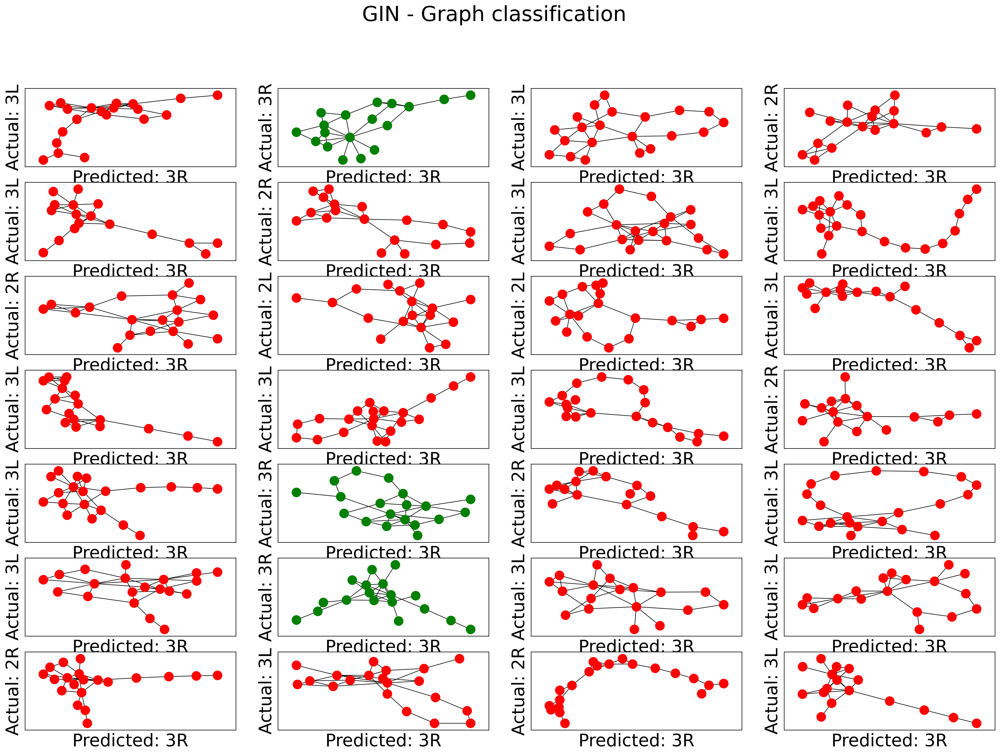

In [ ]:
fig, ax = plt.subplots(7, 4, figsize=(24,16))
fig.suptitle('GIN - Graph classification')
lookup = {0: "2L", 1: "2R", 2: "3L", 3: "3R"}

for i, data in enumerate(dataset[len(dataset) - 28:len(dataset)]):
    # Calculate color (green if correct, red otherwise)
    _, out = gin(data.x, data.edge_index, data.batch)
    #color = "green" # set default color to green
    #if (out.argmax(dim = 1) != data.y):
    # 2L = 0; 2R = 1; 3L = 2, 3R = 3

    color = "green" if out.argmax(dim=1) == data.y else "red"

    # Plot graph
    ix = np.unravel_index(i, ax.shape)
    predicted = out.argmax(dim = 1).numpy()[0]
    actual = data.y.numpy()[0]
    ax[ix].axis('on')
    ax[ix].set_xlabel("Predicted: " + lookup[predicted])
    ax[ix].set_ylabel("Actual: " + lookup[actual])
    G = to_networkx(dataset[i], to_undirected=True)
    nx.draw_networkx(G,
                    pos=nx.spring_layout(G, seed=0),
                    with_labels=False,
                    node_size=150,
                    node_color=color,
                    width=0.8,
                    ax=ax[ix]
                    )

In [ ]:
#gcn.eval()
gin.eval()
acc_gcn = 0
acc_gin = 0
acc = 0

for data in test_loader:
    # Get classifications
    #_, out_gcn = gcn(data.x, data.edge_index, data.batch)
    _, out_gin = gin(data.x, data.edge_index, data.batch)
    out = out_gin

    # Calculate accuracy scores
    #acc_gcn += accuracy(out_gcn.argmax(dim=1), data.y) / len(test_loader)
    acc_gin += accuracy(out_gin.argmax(dim=1), data.y) / len(test_loader)
    acc += accuracy(out.argmax(dim=1), data.y) / len(test_loader)

# Print results
#print(f'GCN accuracy:     {acc_gcn*100:.2f}%')
print(f'GIN accuracy:     {acc_gin*100:.2f}%')
#print(f'GCN+GIN accuracy: {acc*100:.2f}%')

placeholder = np.array([threshold_val, acc_gin])
print(placeholder)
accuracy_collector.append(placeholder)

GIN accuracy:     100.00%
[45.  1.]


In [ ]:
print(accuracy_collector)


[array([37.   ,  0.875])]


In [ ]:
print(len(accuracy_collector))

1


The following are placeholder logics

In [ ]:
(0, 0.24567),(5, 0.26233),(10, 0.29926395),(15, 0.3515625),(20, 0.38446003),(25,0.434375), (30, 0.5), (35,0.63636363), (40, 0.80000001), (45, 1)

((0, 0.24567),
 (5, 0.26233),
 (10, 0.29926395),
 (15, 0.3515625),
 (20, 0.38446003),
 (25, 0.434375),
 (30, 0.5),
 (35, 0.63636363),
 (40, 0.80000001),
 (45, 1))

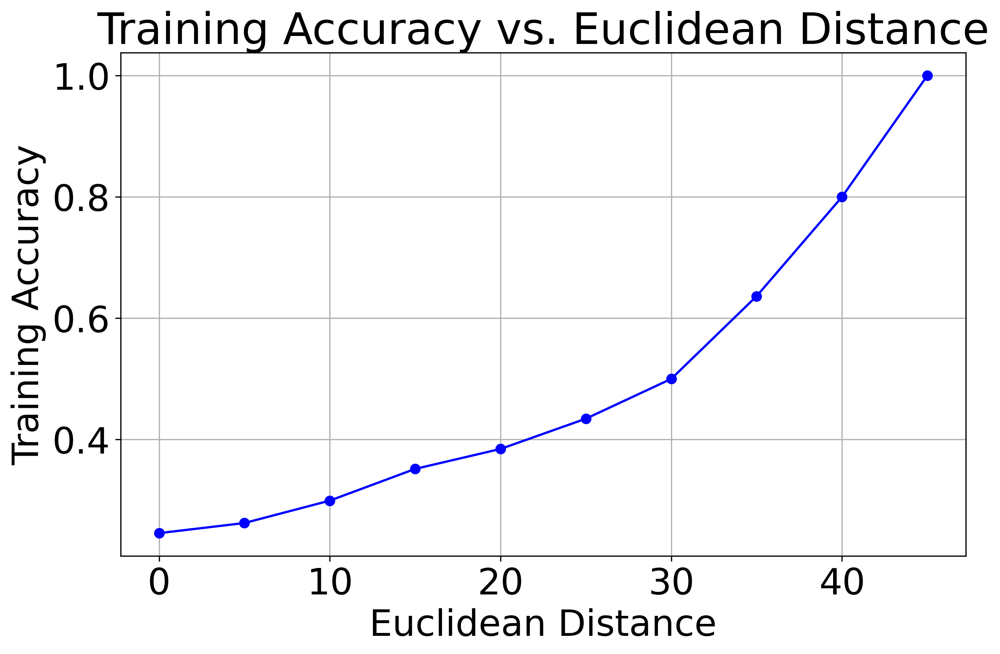

In [ ]:
import matplotlib.pyplot as plt

# Data points
x_values = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
y_values = [0.24567, 0.26233, 0.29926395, 0.3515625, 0.38446003, 0.434375, 0.5, 0.63636363, 0.80000001, 1]

# Plotting the graph
plt.figure(figsize=(10, 6))
plt.plot(x_values, y_values, marker='o', linestyle='-', color='b')

# Adding titles and labels
plt.title('Training Accuracy vs. Euclidean Distance')
plt.xlabel('Euclidean Distance')
plt.ylabel('Training Accuracy')
plt.grid(True)

# Show the plot
plt.show()


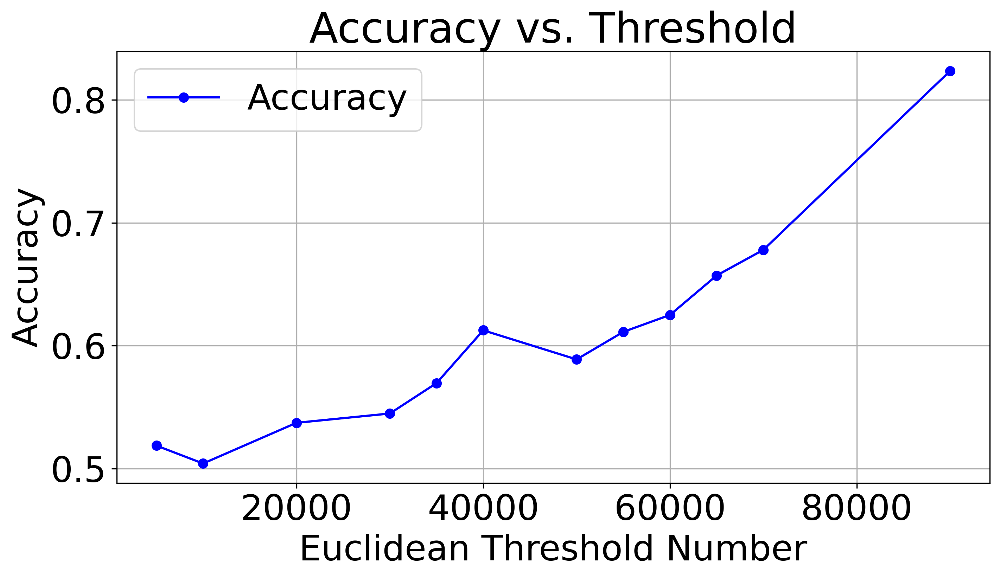

In [ ]:
x_data = [entry[0] for entry in accuracy_collector]
y_data = [entry[1] for entry in accuracy_collector]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(x_data, y_data, marker='o', linestyle='-', color='b', label='Accuracy')
plt.xlabel('Euclidean Threshold Number')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Threshold')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
#placeholder logics

import torch
from torch_geometric.data import Data, InMemoryDataset
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
import numpy as np

class MyCustomDataset(InMemoryDataset):
    def __init__(self, data_list, transform=None, pre_transform=None):
        self.data_list = data_list
        super(MyCustomDataset, self).__init__(None, transform, pre_transform)
        self.data, self.slices = self.collate(data_list)

    @property
    def raw_file_names(self):
        return []

    @property
    def processed_file_names(self):
        return []

    def download(self):
        pass

    def process(self):
        pass

    def len(self):
        return len(self.data_list)

    def get(self, idx):
        return self.data_list[idx]


dataset = []
y = torch.ones_like(placeholder_dataset[0].y.long())

for graph in adjacency_matrix:
    sample = graph.reshape(21, 21)
    node_indices = torch.arange(sample.shape[0], dtype=torch.float).view(-1, 1)
    x = node_indices
    adj_matrix = sp.coo_matrix(sample)
    edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)
    data = Data(x=x, edge_index=edge_index, y=torch.tensor(y, dtype=torch.float))
    dataset.append(data)

dataset = MyCustomDataset(dataset)

# Example: Accessing the first graph in the custom dataset
print(dataset[0])
print("Node feature matrix (x):")
print(dataset[0].x)
print("Edge index:")
print(dataset[0].edge_index)
print("Labels (y):")
print(dataset[0].y)
print(len(dataset))

In [ ]:
import torch
from torch_geometric.data import Data
from torch_geometric.utils import from_scipy_sparse_matrix
import scipy.sparse as sp
from torch_geometric.datasets import TUDataset
# ex) x = [2,1000]
dataset = [] #should not use numpy list
y = np.ones((4,))
for graph in adjacency_matrix:
  sample = graph.reshape(21,21)
  node_indices = torch.arange(sample.shape[0], dtype = torch.float)
  x = torch.cat([node_indices])
  adj_matrix = sp.coo_matrix(sample)
  edge_index, edge_attr = from_scipy_sparse_matrix(adj_matrix)
  data = Data(x = x, edge_index = edge_index,y=y)
  dataset.append(data)
#this is a testing unit